<a href="https://colab.research.google.com/github/federicocanzonieri/DeepLearning/blob/main/DeepLearning3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import random
import numpy as np

np.random.seed(0)
torch.manual_seed(0)
random.seed(0)


In [ ]:
!wget https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/grumpifycat.zip

In [ ]:
!unzip grumpifycat.zip

In [ ]:
import glob 
import random
import os
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as transforms


class ImageDataset(Dataset):
  def __init__(self, root, transform=None, mode='train'):
    self.transform = transform #conserva la transform
    # ottieni i path delle immagini in A e B
    self.files_A = sorted(glob.glob(os.path.join(root, '%sA' % mode) + '/*.*'))
    self.files_B = sorted(glob.glob(os.path.join(root, '%sB' % mode) + '/*.*'))
  
  def __getitem__(self, index):
    #apro l'iesima immagine A (uso il modulo per evitare di sforare)
    item_A = Image.open(self.files_A[index % len(self.files_A)])
    #apro una immagine B a caso
    item_B = Image.open(self.files_B[random.randint(0, len(self.files_B) - 1)])
    
    if self.transform:
      item_A = self.transform(item_A)
      item_B = self.transform(item_B)
    return item_A, item_B

  def __len__(self):
    return max(len(self.files_A), len(self.files_B))


In [ ]:
dset=ImageDataset('grumpifycat')

In [ ]:
from matplotlib import pyplot as plt
import numpy as np
plt.figure(figsize=(12,8))
plt.subplot(121)
plt.imshow(np.array(dset[0][0]))
plt.axis('off')
plt.subplot(122)
plt.imshow(np.array(dset[0][1]))
plt.axis('off')
plt.show()

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class ResidualBlock(nn.Module):
  def __init__(self,in_features):
    super(ResidualBlock,self).__init__()
    conv_block= [ nn.ReflectionPad2d(1),
                  nn.Conv2d(in_features,in_features,3),
                  nn.InstanceNorm2d(in_features),
                  nn.ReLU(inplace=True),
                  nn.ReflectionPad2d(1),
                  nn.Conv2d(in_features,in_features,3),
                  nn.InstanceNorm2d(in_features)]
    self.conv_block=nn.Sequential(*conv_block)

  def forward(self,x):
    return x + self.conv_block(x)


In [ ]:
class Generator(nn.Module):
  def __init__(self,input_nc,output_nc,n_res_block=9):
    super(Generator,self).__init__()
    model = [nn.ReflectionPad2d(3),
             nn.Conv2d(input_nc,64,7),
             nn.InstanceNorm2d(64),
             nn.ReLU(inplace=True)]
    
    in_features=64
    out_features=in_features*2

    for _ in range(2):
      model+=[ nn.Conv2d(in_features,out_features,3,stride=2,padding=1),
               nn.InstanceNorm2d(out_features),
               nn.ReLU(inplace=True)]
      in_features=out_features
      out_features=in_features*2

    for _ in range(n_res_block):
      model+=[ResidualBlock(in_features)]

    out_features=in_features//2
    for _ in range(2):
      model+=[nn.ConvTranspose2d(in_features,out_features,3,stride=2,padding=1,output_padding=1),
              nn.InstanceNorm2d(out_features),
              nn.ReLU(inplace=True)]
      in_features=out_features
      out_features=in_features//2
    
    model+=[nn.ReflectionPad2d(3),
            nn.Conv2d(64,output_nc,7),
            nn.Tanh()]
    self.model=nn.Sequential(*model)

  def forward(self,x):
    return self.model(x)
    


In [ ]:
!pip install torchsummary

In [ ]:
from torchsummary import summary

gen=Generator(3,3).cuda()
summary(gen,(3,224,224))

In [ ]:
class Discriminator(nn.Module):
  def __init__(self,input_nc):
    super(Discriminator,self).__init__()

    model=[nn.Conv2d(input_nc,64,4,stride=2,padding=1),
            nn.LeakyReLU(0.2,inplace=True)]
    model+=[nn.Conv2d(64,128,4,stride=2,padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2,inplace=True)]
    model+=[nn.Conv2d(128,256,4,stride=2,padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2,inplace=True)]
    model+=[nn.Conv2d(256,512,4,padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2,inplace=True)]
    
    model+=[nn.Conv2d(512,1,4,padding=1)]
    self.model=nn.Sequential(*model)

  def forward(self,x):
    x=self.model(x)

    return F.avg_pool2d(x,x.size()[2:]).view(x.size()[0],-1)


In [ ]:
from torchsummary import summary
disc = Discriminator(3).cuda()
summary(disc, (3,224,224))

In [ ]:
disc(torch.zeros(1,3,224,224).cuda()).shape

In [ ]:
class LambdaLR():
  def __init__(self,n_epochs,offset,decay_start_epoch):
    assert ((n_epochs-decay_start_epoch)>0),"Decay must start before the training sess"
    self.n_epochs=n_epochs
    self.offset=offset
    self.decay_start_epoch=decay_start_epoch

  def step(self,epoch):
    return 1.0 - max(0,epoch+self.offset-self.decay_start_epoch)/(self.n_epochs-self.decay_start_epoch)

def weights_init_normal(m):
  classname = m.__class__.__name__
  # Inizializziamo le convoluzioni con rumore gaussiano
  # di media zero e deviazione standard 0.02
  if classname.find('Conv') != -1:
    m.weight.data.normal_(0.0, 0.02)
  # Nel caso della batchnorm2d useremo media 1 e deviazione standard 0.02
  elif classname.find('BatchNorm2d') != -1:
    m.weight.data.normal_(1.0, 0.02)
    # il bias è costante e pari a zero
    m.bias.data.fill_(0.0)
      

In [ ]:
!pip install pytorch_lightning

     |████████████████████████████████| 525 kB 7.9 MB/s 
     |████████████████████████████████| 132 kB 49.6 MB/s 
     |████████████████████████████████| 332 kB 62.6 MB/s 
     |████████████████████████████████| 829 kB 44.1 MB/s 
     |████████████████████████████████| 596 kB 53.5 MB/s 
     |████████████████████████████████| 1.1 MB 56.0 MB/s 
     |████████████████████████████████| 271 kB 39.0 MB/s 
     |████████████████████████████████| 160 kB 61.0 MB/s 
     |████████████████████████████████| 192 kB 62.3 MB/s 
  Created wheel for future: filename=future-0.18.2-py3-none-any.whl size=491070 sha256=2cbca6c70cf942571c8bc1af890aece3c5329d5efb33a3d3224c5ca6f2d1000c
  Stored in directory: /root/.cache/pip/wheels/56/b0/fe/4410d17b32f1f0c3cf54cdfb2bc04d7b4b8f4ae377e2229ba0
Successfully built future
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Attempting uninstall: future
    Found exis

In [ ]:
import pytorch_lightning as pl
import itertools
from torch.utils.data import DataLoader
import torchvision

# lambdaR=LambdaLR()

class CycleGAN(pl.LightningModule):
  def __init__(self, 
    input_nc = 3, # numero di canali in input
    output_nc = 3, # numero di canali in output
    image_size = 256, # la dimensione dell'immagine
    lr=0.0002, # learning rate
    betas=(0.5, 0.999), # valori beta di Adam
    starting_epoch=0, # epoca di partenza (0 se non stiamo facendo resume di un training interrotto)
    n_epochs=200, # numero totale di epoche
    decay_epoch=100, # epoca dopo la quale iniziare a far scendere il learning rate
    data_root = 'grumpifycat', #cartella in cui si trovano i dati
    batch_size = 1, #batch size
    n_cpu = 8 # numeri di thread per il dataloader
    ):
    super(CycleGAN, self).__init__()
    self.save_hyperparameters()
    
    # Definiamo due generatori: da A a B e da B ad A
    self.netG_A2B = Generator(input_nc, output_nc)
    self.netG_B2A = Generator(output_nc, input_nc)
    
    # Definiamo due discriminatori: uno per A e uno per B
    self.netD_A = Discriminator(input_nc)
    self.netD_B = Discriminator(output_nc)
    
    # Applichiamo la normalizzazione
    self.netG_A2B.apply(weights_init_normal)
    self.netG_B2A.apply(weights_init_normal)
    self.netD_A.apply(weights_init_normal)
    self.netD_B.apply(weights_init_normal)
    
    # Definiamo le loss
    self.criterion_GAN = torch.nn.MSELoss()
    self.criterion_cycle = torch.nn.L1Loss()
    self.criterion_identity = torch.nn.L1Loss()
    
  def forward(self, x, mode='A2B'):
    if mode=='A2B':
      return netG_A2B(x)
    else:
      return netG_B2A(x)
    
  # ci servono 3 optimizer, ognuno con il suo scheduler
  def configure_optimizers(self):
    # Optimizer per il generatore
    optimizer_G = torch.optim.Adam(itertools.chain(self.netG_A2B.parameters(), self.netG_B2A.parameters()),lr=self.hparams.lr, betas=self.hparams.betas)
    
    # Optimizers per i due discriminatori
    optimizer_D_A = torch.optim.Adam(self.netD_A.parameters(), lr=self.hparams.lr,    betas=self.hparams.betas)
    optimizer_D_B = torch.optim.Adam(self.netD_B.parameters(), lr=self.hparams.lr,    betas=self.hparams.betas)
    
    lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(optimizer_G, lr_lambda=LambdaLR(self.hparams.n_epochs, self.hparams.starting_epoch, self.hparams.decay_epoch).step)
    lr_scheduler_D_A = torch.optim.lr_scheduler.LambdaLR(optimizer_D_A, lr_lambda=LambdaLR(self.hparams.n_epochs, self.hparams.starting_epoch, self.hparams.decay_epoch).step)
    lr_scheduler_D_B = torch.optim.lr_scheduler.LambdaLR(optimizer_D_B, lr_lambda=LambdaLR(self.hparams.n_epochs, self.hparams.starting_epoch, self.hparams.decay_epoch).step)
  
    # Restituiamo i tre optimizer e i tre optimizers
    return [optimizer_G, optimizer_D_A, optimizer_D_B], [lr_scheduler_G, lr_scheduler_D_A, lr_scheduler_D_B]

  def training_step(self, batch, batch_idx, optimizer_idx):
    real_A, real_B = batch
    
    target_real = torch.ones((real_A.shape[0],1)).type_as(real_A)
    target_fake = torch.zeros((real_A.shape[0],1)).type_as(real_A)
    
    # optimizer del generatore
    if optimizer_idx==0:
    # Identity loss
    # G_A2B(B) should equal B if real B is fed
      same_B = self.netG_A2B(real_B) # passa B al generatore A2B - deve essere uguale a B
      loss_identity_B = self.criterion_identity(same_B, real_B)*5.0
      # G_B2A(A) should equal A if real A is fed
      same_A = self.netG_B2A(real_A) # passa A al generatore B2A - deve essere uguale ad A
      loss_identity_A = self.criterion_identity(same_A, real_A)*5.0
      # GAN loss
      fake_B = self.netG_A2B(real_A) # passa A ad A2B - sono le fake B
      pred_fake = self.netD_B(fake_B) # predizioni del discriminatore B
      loss_GAN_A2B = self.criterion_GAN(pred_fake, target_real) # loss GAN per A2B
      fake_A = self.netG_B2A(real_B) # passa B a B2A - sono le fake A
      pred_fake = self.netD_A(fake_A) # predizioni del discriminatore A
      loss_GAN_B2A = self.criterion_GAN(pred_fake, target_real) # loss GAN per B2A
      # Cycle consistency loss
      recovered_A = self.netG_B2A(fake_B) #passiamo le fake B a B2A - devono essere uguali a real_A
      loss_cycle_ABA = self.criterion_cycle(recovered_A, real_A)*10.0 #cycle consistency loss
      recovered_B = self.netG_A2B(fake_A) #passiamo le fake A a A2B - devono essere uguali a real_B
      loss_cycle_BAB = self.criterion_cycle(recovered_B, real_B)*10.0 #cycle consistency loss
      # loss globale
      loss_G = loss_identity_A + loss_identity_B + loss_GAN_A2B + loss_GAN_B2A + loss_cycle_ABA + loss_cycle_BAB
      self.log('loss_G/loss_identity_A', loss_identity_A)
      self.log('loss_G/loss_identity_B', loss_identity_B)
      self.log('loss_G/loss_GAN_A2B', loss_GAN_A2B)
      self.log('loss_G/loss_GAN_B2A', loss_GAN_B2A)
      self.log('loss_G/loss_cycle_ABA', loss_cycle_ABA)
      self.log('loss_G/loss_cycle_BAB', loss_cycle_BAB)
      self.log('loss_G/overall', loss_G)
      
    # loggiamo dei campioni visivi da ispezionare durante il training ogni 100 batch
      if batch_idx % 100 ==0:
        grid_A = torchvision.utils.make_grid(real_A[:50], nrow=10, normalize=True)
        grid_A2B = torchvision.utils.make_grid(fake_B[:50], nrow=10, normalize=True)
        grid_A2B2A = torchvision.utils.make_grid(recovered_A[:50], nrow=10, normalize=True)
        
        grid_B = torchvision.utils.make_grid(real_B[:50], nrow=10, normalize=True)
        grid_B2A = torchvision.utils.make_grid(fake_A[:50], nrow=10, normalize=True)
        grid_B2A2B = torchvision.utils.make_grid(recovered_B[:50], nrow=10, normalize=True)
        
        self.logger.experiment.add_image('A/A', grid_A, self.global_step)
        self.logger.experiment.add_image('A/A2B', grid_A2B, self.global_step)
        self.logger.experiment.add_image('A/A2B2A', grid_A2B2A, self.global_step)
        
        self.logger.experiment.add_image('B/B', grid_B, self.global_step)
        self.logger.experiment.add_image('B/B2A', grid_B2A, self.global_step)
        self.logger.experiment.add_image('B/B2A2B', grid_B2A2B, self.global_step)
        
        return loss_G
    
    elif optimizer_idx==1: #discriminatore A
    # Real loss
      pred_real = self.netD_A(real_A)
      loss_D_real = self.criterion_GAN(pred_real, target_real)
      # Fake loss
      fake_A = self.netG_B2A(real_B) # passa B a B2A - sono le fake A
      pred_fake = self.netD_A(fake_A.detach())
      loss_D_fake = self.criterion_GAN(pred_fake, target_fake)
      # loss globale
      loss_D_A = (loss_D_real + loss_D_fake)*0.5
      self.log('loss_D/loss_D_A',loss_D_A)
      return loss_D_A
    
    elif optimizer_idx==2: #discriminatore B
      pred_real = self.netD_B(real_B)
      loss_D_real = self.criterion_GAN(pred_real, target_real)
      # Fake loss
      fake_B = self.netG_A2B(real_A) # passa A ad A2B - sono le fake B
      pred_fake = self.netD_B(fake_B.detach())
      loss_D_fake = self.criterion_GAN(pred_fake, target_fake)
      # loss globale
      loss_D_B = (loss_D_real + loss_D_fake)*0.5
      self.log('loss_D/loss_D_B', loss_D_B)
      return loss_D_B

  def train_dataloader(self):
      transform = transforms.Compose([
        transforms.Resize(int(self.hparams.image_size*1.12), Image.BICUBIC), #ridimensioniamo a una dimensione più grande di quella di input
        transforms.RandomCrop(self.hparams.image_size), #random crop alla dimensione di input
        transforms.RandomHorizontalFlip(), #random flip orizzontale
        transforms.ToTensor(), #trasformiamo in tensore
        transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)) #applichiamo la normalizzazione
      ])
      
      dataloader = DataLoader(ImageDataset(self.hparams.data_root, transform=transform), 
      batch_size=self.hparams.batch_size, shuffle=True, num_workers=self.hparams.n_cpu)
      return dataloader


In [ ]:
%load_ext tensorboard 
%tensorboard --logdir tb_logs

<IPython.core.display.Javascript object>

In [ ]:
from pytorch_lightning.loggers import TensorBoardLogger
cycle_gan = CycleGAN(data_root='grumpifycat')
logger = TensorBoardLogger("tb_logs", name="grumpifycat_cyclegan")
trainer = pl.Trainer(gpus=1, logger=logger, max_epochs=50)
trainer.fit(cycle_gan)

NameError: ignored

In [ ]:
mod = CycleGAN.load_from_checkpoint('tb_logs/grumpifycat_cyclegan/version_1/checkpoints/epoch=199-step=42799.ckpt')

In [ ]:
dset = mod.train_dataloader().dataset

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:288: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
from matplotlib import pyplot as plt
def print_example_A2B(i):
  image_in = dset[i][0]
  a2b = mod.netG_A2B(image_in.unsqueeze(0))
  a2b2a = mod.netG_B2A(a2b)
  image_in = image_in.detach().numpy().transpose(1,2,0)
  image_in-=image_in.min()
  image_in/=image_in.max()
  a2b = a2b.squeeze().detach().numpy().transpose(1,2,0)
  a2b-=a2b.min()
  a2b/=a2b.max()
  
  a2b2a = a2b2a.squeeze().detach().numpy().transpose(1,2,0)
  a2b2a-=a2b2a.min()
  a2b2a/=a2b2a.max()
  plt.figure(figsize=(12,8))
  plt.subplot(131)
  plt.imshow(image_in)
  plt.title('A')
  plt.axis('off')
  
  plt.subplot(132)
  plt.imshow(a2b)
  plt.title('A2B')
  plt.axis('off')
  
  plt.subplot(133)
  plt.imshow(a2b2a)
  plt.title('A2B2A')
  plt.axis('off')

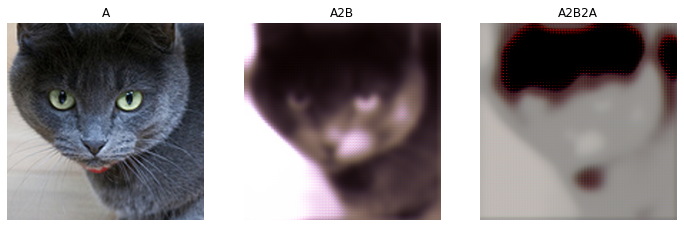

In [ ]:
 print_example_A2B(0)

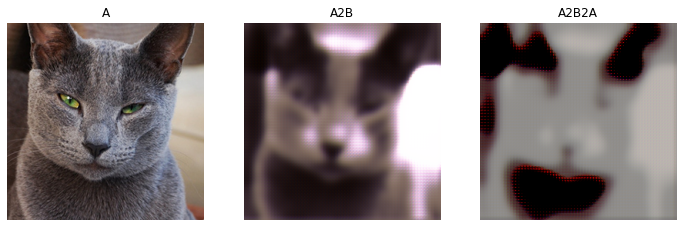

In [ ]:
 print_example_A2B(300)

In [ ]:
 print_example_A2B(128)

## Feature level adaptation


In [ ]:
class MNISTM(Dataset):
    """`MNIST-M Dataset."""

    url = "https://github.com/VanushVaswani/keras_mnistm/releases/download/1.0/keras_mnistm.pkl.gz"

    raw_folder = "raw"
    processed_folder = "processed"
    training_file = "mnist_m_train.pt"
    test_file = "mnist_m_test.pt"

    def __init__(self, root, mnist_root="data", train=True, transform=None, target_transform=None, download=False):
        """Init MNIST-M dataset."""
        super(MNISTM, self).__init__()
        self.root = os.path.expanduser(root)
        self.mnist_root = os.path.expanduser(mnist_root)
        self.transform = transform
        self.target_transform = target_transform
        self.train = train  # training set or test set

        if download:
            self.download()

        if not self._check_exists():
            raise RuntimeError("Dataset not found." + " You can use download=True to download it")

        if self.train:
            self.train_data, self.train_labels = torch.load(
                os.path.join(self.root, self.processed_folder, self.training_file)
            )
        else:
            self.test_data, self.test_labels = torch.load(
                os.path.join(self.root, self.processed_folder, self.test_file)
            )

    def __getitem__(self, index):
        """Get images and target for data loader.
        Args:
            index (int): Index
        Returns:
            tuple: (image, target) where target is index of the target class.
        """
        if self.train:
            img, target = self.train_data[index], self.train_labels[index]
        else:
            img, target = self.test_data[index], self.test_labels[index]

        # doing this so that it is consistent with all other datasets
        # to return a PIL Image
        img = Image.fromarray(img.squeeze().numpy(), mode="RGB")

        if self.transform is not None:
            img = self.transform(img)

        if self.target_transform is not None:
            target = self.target_transform(target)

        return img, target

    def __len__(self):
        """Return size of dataset."""
        if self.train:
            return len(self.train_data)
        else:
            return len(self.test_data)

    def _check_exists(self):
        return os.path.exists(os.path.join(self.root, self.processed_folder, self.training_file)) and os.path.exists(
            os.path.join(self.root, self.processed_folder, self.test_file)
        )

    def download(self):
        """Download the MNIST data."""
        # import essential packages
        from six.moves import urllib
        import gzip
        import pickle
        from torchvision import datasets

        # check if dataset already exists
        if self._check_exists():
            return

        # make data dirs
        try:
            os.makedirs(os.path.join(self.root, self.raw_folder))
            os.makedirs(os.path.join(self.root, self.processed_folder))
        except OSError as e:
            if e.errno == errno.EEXIST:
                pass
            else:
                raise

        # download pkl files
        print("Downloading " + self.url)
        filename = self.url.rpartition("/")[2]
        file_path = os.path.join(self.root, self.raw_folder, filename)
        if not os.path.exists(file_path.replace(".gz", "")):
            data = urllib.request.urlopen(self.url)
            with open(file_path, "wb") as f:
                f.write(data.read())
            with open(file_path.replace(".gz", ""), "wb") as out_f, gzip.GzipFile(file_path) as zip_f:
                out_f.write(zip_f.read())
            os.unlink(file_path)

        # process and save as torch files
        print("Processing...")

        # load MNIST-M images from pkl file
        with open(file_path.replace(".gz", ""), "rb") as f:
            mnist_m_data = pickle.load(f, encoding="bytes")
        mnist_m_train_data = torch.ByteTensor(mnist_m_data[b"train"])
        mnist_m_test_data = torch.ByteTensor(mnist_m_data[b"test"])

        # get MNIST labels
        mnist_train_labels = datasets.MNIST(root=self.mnist_root, train=True, download=True).train_labels
        mnist_test_labels = datasets.MNIST(root=self.mnist_root, train=False, download=True).test_labels

        # save MNIST-M dataset
        training_set = (mnist_m_train_data, mnist_train_labels)
        test_set = (mnist_m_test_data, mnist_test_labels)
        with open(os.path.join(self.root, self.processed_folder, self.training_file), "wb") as f:
            torch.save(training_set, f)
        with open(os.path.join(self.root, self.processed_folder, self.test_file), "wb") as f:
            torch.save(test_set, f)

        print("Done!")

In [ ]:
mnistm_train = MNISTM(root='data', train=True, download=True)

NameError: ignored

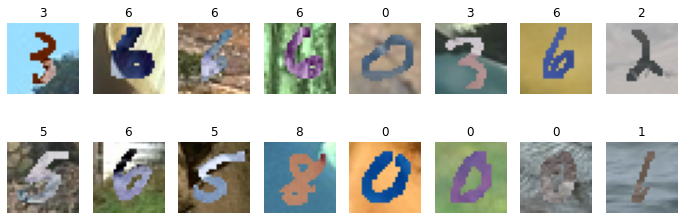

In [ ]:
j=1
plt.figure(figsize=(12,4))
for i in np.random.permutation(len(mnistm_train))[:16]:
    plt.subplot(2,8,j)
    plt.imshow(np.array(mnistm_train[i][0]))
    plt.title(mnistm_train[i][1].item())
    plt.axis('off')
    j+=1
plt.show()

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting data/MNIST/raw/train-images-idx3-ubyte.gz to data/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting data/MNIST/raw/train-labels-idx1-ubyte.gz to data/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting data/MNIST/raw/t10k-images-idx3-ubyte.gz to data/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting data/MNIST/raw/t10k-labels-idx1-ubyte.gz to data/MNIST/raw



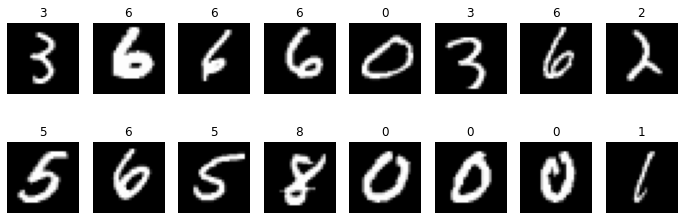

In [ ]:
from torchvision.datasets import MNIST
mnist_train = MNIST(root = 'data',train=True, download=True)
j=1
plt.figure(figsize=(12,4))
for i in np.random.permutation(len(mnist_train))[:16]:
    plt.subplot(2,8,j)
    plt.imshow(np.array(mnist_train[i][0]), cmap='gray')
    plt.title(mnist_train[i][1])
    plt.axis('off')
    j+=1
plt.show()

In [ ]:
transform = transforms.Compose([
    transforms.Lambda(lambda x: x.convert('RGB')),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
])

mnist_train = MNIST('data', train=True, transform=transform, download=True)
mnist_test = MNIST('data', train=False, transform=transform, download=True)

mnist_train_loader = DataLoader(mnist_train, batch_size=256, shuffle=True, num_workers=8)
mnist_test_loader = DataLoader(mnist_test, batch_size=256, num_workers=8)

mnistm_train = MNISTM('data', train=True, transform=transform, download=True)
mnistm_test = MNISTM('data', train=False, transform=transform, download=True)

mnistm_train_loader = DataLoader(mnistm_train, batch_size=256, shuffle=True, num_workers=8)
mnistm_test_loader = DataLoader(mnistm_test, batch_size=256, num_workers=8)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
from torch import nn

class Net(nn.Module):
    def __init__(self):
        super().__init__()
        # modello feature extractor
        self.feature_extractor = nn.Sequential(
            # primo layer di convoluzioni
            nn.Conv2d(3, 10, kernel_size=5),
            nn.MaxPool2d(2),
            nn.ReLU(),
            # secondo layer di convoluzioni
            nn.Conv2d(10, 20, kernel_size=5),
            nn.MaxPool2d(2),
            nn.Dropout2d(),
        )
        
        # modulo di classificazione a partire dalle feature
        self.classifier = nn.Sequential(
            nn.Linear(320, 50),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(50, 10),
        )

    def forward(self, x):
        # estrazione delle feature
        features = self.feature_extractor(x)
        # reshape delle features
        features = features.view(x.shape[0], -1)
        # otteniamo i logits mediante il classificatore
        logits = self.classifier(features)
        return logits

In [ ]:
mod = Net().cuda()
summary(mod, (3,28,28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 10, 24, 24]             760
         MaxPool2d-2           [-1, 10, 12, 12]               0
              ReLU-3           [-1, 10, 12, 12]               0
            Conv2d-4             [-1, 20, 8, 8]           5,020
         MaxPool2d-5             [-1, 20, 4, 4]               0
         Dropout2d-6             [-1, 20, 4, 4]               0
            Linear-7                   [-1, 50]          16,050
              ReLU-8                   [-1, 50]               0
           Dropout-9                   [-1, 50]               0
           Linear-10                   [-1, 10]             510
Total params: 22,340
Trainable params: 22,340
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.01
Forward/backward pass size (MB): 0.08
Params size (MB): 0.09
Estimated Tot

In [ ]:
from torch.optim import SGD
from sklearn.metrics import accuracy_score

class ClassificationTask(pl.LightningModule):
    def __init__(self, model):
        super(ClassificationTask, self).__init__() 
        self.model = model
        self.criterion = nn.CrossEntropyLoss() 
        
    def forward(self,x):
        return self.model(x)
    
    def configure_optimizers(self):
        return torch.optim.Adam(self.model.parameters())
    
    def training_step(self, train_batch, batch_idx):
        x, y = train_batch
        output = self.forward(x)
        loss = self.criterion(output,y)
        self.log('train/loss', loss)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch
        output = self.forward(x)
        
        return {
            'predictions': output.cpu().topk(1).indices,
            'labels': y.cpu()
        }
        
    def validation_epoch_end(self, outputs):
        predictions = np.concatenate([o['predictions'] for o in outputs])
        labels = np.concatenate([o['labels'] for o in outputs])
        
        acc = accuracy_score(labels, predictions)
        
        self.log('val/accuracy', acc)
        
    def test_step(self, test_batch, batch_idx):
        x, y = test_batch
        output = self.forward(x)
        
        return {
            'predictions': output.cpu().topk(1).indices,
            'labels': y.cpu()
        }
        
    def test_epoch_end(self, outputs):
        predictions = np.concatenate([o['predictions'] for o in outputs])
        labels = np.concatenate([o['labels'] for o in outputs])
        
        acc = accuracy_score(labels, predictions)
        
        self.log('test/accuracy', acc)

In [ ]:
mnist_noadapt = ClassificationTask(Net())

logger = TensorBoardLogger("adaptation_logs", name="mnist_noadapt")

mnist_noadapt_trainer = pl.Trainer(max_epochs=10, gpus=1, logger=logger)
mnist_noadapt_trainer.fit(mnist_noadapt, mnist_train_loader, mnist_test_loader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | model     | Net              | 22.3 K
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
22.3 K    Trainable params
0         Non-trainable params
22.3 K    Total params
0.089     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
mnist_noadapt_mnist_accuracy = mnist_noadapt_trainer.test(dataloaders=mnist_test_loader)[0]['test/accuracy']

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at adaptation_logs/mnist_noadapt/version_0/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnist_noadapt/version_0/checkpoints/epoch=9-step=2349.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.9876000285148621}
--------------------------------------------------------------------------------


In [ ]:
mnist_noadapt_mnistm_accuracy = mnist_noadapt_trainer.test(dataloaders=mnistm_test_loader)[0]['test/accuracy']

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at adaptation_logs/mnist_noadapt/version_0/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnist_noadapt/version_0/checkpoints/epoch=9-step=2349.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.5663999915122986}
--------------------------------------------------------------------------------


In [ ]:
mnistm_noadapt = ClassificationTask(Net())

logger = TensorBoardLogger("adaptation_logs", name="mnistm_noadapt")

mnistm_noadapt_trainer = pl.Trainer(max_epochs=10, gpus=1, logger=logger)
mnistm_noadapt_trainer.fit(mnistm_noadapt, mnistm_train_loader, mnistm_test_loader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type             | Params
-----------------------------------------------
0 | model     | Net              | 22.3 K
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
22.3 K    Trainable params
0         Non-trainable params
22.3 K    Total params
0.089     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
mnistm_noadapt_mnistm_accuracy = mnistm_noadapt_trainer.test(dataloaders=mnistm_test_loader)[0]['test/accuracy']

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at adaptation_logs/mnistm_noadapt/version_0/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnistm_noadapt/version_0/checkpoints/epoch=9-step=2349.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.9502999782562256}
--------------------------------------------------------------------------------


In [ ]:
import pandas as pd
results = pd.DataFrame({
    'Model':['No Adaptation', 'Oracle'],
    'MNIST':[mnist_noadapt_mnist_accuracy, '-'],
    'MNISTM': [mnist_noadapt_mnistm_accuracy, mnistm_noadapt_mnistm_accuracy]
})
results

,Model,MNIST,MNISTM
0,No Adaptation,0.9876,0.5664
1,Oracle,-,0.9503


In [ ]:
from torch.autograd import Function
class RevGrad(Function):
    @staticmethod
    def forward(ctx, input_, lambda_):
        lambda_ = torch.Tensor([lambda_]).type_as(input_)
        ctx.save_for_backward(input_, lambda_)
        output = input_
        return output

    @staticmethod
    def backward(ctx, grad_output):  # pragma: no cover
        grad_input = None
        _, lambda_ = ctx.saved_tensors
        if ctx.needs_input_grad[0]:
            grad_input = -grad_output * lambda_
        return grad_input, None


revgrad = RevGrad.apply

In [ ]:
class DiscriminatorGRL(torch.nn.Module):
    def __init__(self):
        super(DiscriminatorGRL, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(320, 50),
            nn.ReLU(),
            nn.Linear(50, 20),
            nn.ReLU(),
            nn.Linear(20, 1)
    )

    def forward(self, x, lambda_=1):
        return self.model(revgrad(x, lambda_))

In [ ]:
disc = DiscriminatorGRL().cuda()
summary(disc, (320,))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                   [-1, 50]          16,050
              ReLU-2                   [-1, 50]               0
            Linear-3                   [-1, 20]           1,020
              ReLU-4                   [-1, 20]               0
            Linear-5                    [-1, 1]              21
Total params: 17,091
Trainable params: 17,091
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.00
Params size (MB): 0.07
Estimated Total Size (MB): 0.07
----------------------------------------------------------------


In [ ]:
class MultiDomainDataset(Dataset):
    def __init__(self, source_dataset, target_dataset):
        self.source = source_dataset
        self.target = target_dataset
        
    def __getitem__(self, index):
        im_source, lab_source = self.source[index]
        im_target, _ = self.target[random.randint(0, len(self.target)-1)]
        
        return im_source, im_target, lab_source

    def __len__(self):
        return len(self.source)

In [ ]:
mnist_mnistm_train = MultiDomainDataset(mnist_train, mnistm_train)
mnist_mnistm_train_loader = DataLoader(mnist_mnistm_train, shuffle=True, num_workers=8, batch_size=256)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
class DomainAdaptationGRLTask(pl.LightningModule):
    def __init__(self, model):
        super(DomainAdaptationGRLTask, self).__init__() 
        self.model = model
        self.discriminator = DiscriminatorGRL()
        
    def forward(self,x):
        return self.model(x)
    
    def configure_optimizers(self):
        return torch.optim.Adam(list(self.model.parameters()) + list(self.discriminator.parameters()))
    
    def training_step(self, train_batch, batch_idx):
        source, target, labels = train_batch
        
        source_features = self.model.feature_extractor(source).view(source.shape[0], -1)
        target_features = self.model.feature_extractor(target).view(target.shape[0], -1)
        
        label_preds = self.model.classifier(source_features)
        
        # calcoliamo il valore di lambda, che secondo la pubblicazione originale viene fatto
        # crescere da 0 a 1 nel tempo secondo questa formula
        l=2/(1+np.exp(-10*self.current_epoch/NUM_EPOCHS)) - 1
        
        domain_preds_source = self.discriminator(source_features, l)
        domain_preds_target = self.discriminator(target_features, l)
        domain_preds = torch.cat([domain_preds_source, domain_preds_target],0)
        
        source_acc = (torch.sigmoid(domain_preds_source)<0.5).float().mean()
        target_acc = (torch.sigmoid(domain_preds_target)>=0.5).float().mean()
        acc = (source_acc+target_acc)/2
        
        source_targets = torch.zeros(source.shape[0],1)
        target_targets = torch.ones(target.shape[0],1)
        domain_targets = torch.cat([source_targets, target_targets],0).type_as(source)
        
        label_loss = F.cross_entropy(label_preds, labels)
        domain_loss = F.binary_cross_entropy_with_logits(domain_preds, domain_targets)
        
        loss = domain_loss + label_loss
        
        self.log('train/domain_loss', domain_loss)
        self.log('train/label_loss', label_loss)
        self.log('train/loss', loss)
        self.log('train/disc_source_acc',source_acc)
        self.log('train/disc_target_acc',target_acc)
        self.log('train/disc_acc',acc)
        return loss
    
    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch
        output = self.forward(x)
        
        return {
            'predictions': output.cpu().topk(1).indices,
            'labels': y.cpu()
        }
        
    def validation_epoch_end(self, outputs):
        predictions = np.concatenate([o['predictions'] for o in outputs])
        labels = np.concatenate([o['labels'] for o in outputs])
        
        acc = accuracy_score(labels, predictions)
        
        self.log('val/accuracy', acc)
        
    def test_step(self, test_batch, batch_idx):
        x, y = test_batch
        output = self.forward(x)
        
        return {
            'predictions': output.cpu().topk(1).indices,
            'labels': y.cpu()
        }
        
    def test_epoch_end(self, outputs):
        predictions = np.concatenate([o['predictions'] for o in outputs])
        labels = np.concatenate([o['labels'] for o in outputs])
        
        acc = accuracy_score(labels, predictions)
        
        self.log('test/accuracy', acc)

In [ ]:
mnist_grl = DomainAdaptationGRLTask(Net())

logger = TensorBoardLogger("adaptation_logs", name="mnist_grl")
NUM_EPOCHS=10
mnist_grl_trainer = pl.Trainer(max_epochs=NUM_EPOCHS, gpus=1, logger=logger)
mnist_grl_trainer.fit(mnist_grl, mnist_mnistm_train_loader, mnistm_test_loader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type             | Params
---------------------------------------------------
0 | model         | Net              | 22.3 K
1 | discriminator | DiscriminatorGRL | 17.1 K
---------------------------------------------------
39.4 K    Trainable params
0         Non-trainable params
39.4 K    Total params
0.158     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
mnistm_grl_mnistm_accuracy = mnist_grl_trainer.test(dataloaders=mnistm_test_loader)[0]['test/accuracy']

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at adaptation_logs/mnist_grl/version_1/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnist_grl/version_1/checkpoints/epoch=9-step=2349.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.7368999719619751}
--------------------------------------------------------------------------------


In [ ]:
mnistm_grl_mnist_accuracy = mnist_grl_trainer.test(dataloaders=mnist_test_loader)[0]['test/accuracy']

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at adaptation_logs/mnist_grl/version_1/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnist_grl/version_1/checkpoints/epoch=9-step=2349.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.9750999808311462}
--------------------------------------------------------------------------------


In [ ]:
results = pd.DataFrame({
    'Model':['No Adaptation', 'GRL', 'Oracle'],
    'MNIST':[mnist_noadapt_mnist_accuracy, mnistm_grl_mnist_accuracy, '-'],
    'MNISTM': [mnist_noadapt_mnistm_accuracy, mnistm_grl_mnistm_accuracy, mnistm_noadapt_mnistm_accuracy]
})
results

,Model,MNIST,MNISTM
0,No Adaptation,0.9876,0.5664
1,GRL,0.9751,0.7369
2,Oracle,-,0.9503


In [ ]:
class Discriminator(torch.nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(320, 50),
            nn.ReLU(),
            nn.Linear(50, 20),
            nn.ReLU(),
            nn.Linear(20, 1)
    )

    def forward(self, x):
        return self.model(x)

In [ ]:
class ADDATask(pl.LightningModule):
    def __init__(self, source_model):
        super(ADDATask, self).__init__() 
        self.source_model = source_model
        self.target_model = Net()
        self.target_model.load_state_dict(self.source_model.state_dict())
        self.target_model = self.target_model.feature_extractor
        
        self.discriminator = Discriminator()
        self.criterion = nn.BCEWithLogitsLoss()
        
    def forward(self,x):
        features = self.target_model(x).view(x.shape[0],-1)
        return self.source_model.classifier(features)
    
    def configure_optimizers(self):
        return torch.optim.Adam(self.discriminator.parameters()), torch.optim.Adam(self.target_model.parameters())
    
    def training_step(self, train_batch, batch_idx, optimizer_idx):
        source, target, labels = train_batch
        
        if optimizer_idx==0: #train discriminator
            source_features = self.source_model.feature_extractor(source).view(source.shape[0], -1)
            target_features = self.target_model(target).view(target.shape[0], -1)
            
            discriminator_x = torch.cat([source_features, target_features]) ##predicted
            discriminator_y = torch.cat([torch.ones(source.shape[0]).type_as(source),
                                             torch.zeros(target.shape[0]).type_as(source)]) ##groundtruth
            
            preds = self.discriminator(discriminator_x).squeeze()
            loss = self.criterion(preds, discriminator_y)
            
            self.log('train/d_loss', loss)
            
            return loss
        
        else: #train generator
            target_features = self.target_model(target).view(target.shape[0], -1)
            
            # flipped labels
            discriminator_y = torch.ones(target.shape[0]).type_as(source)
            
            preds = self.discriminator(target_features).squeeze()
            loss = self.criterion(preds, discriminator_y)
            
            self.log('train/g_loss', loss)
            
            return loss
    
    def validation_step(self, val_batch, batch_idx):
        x, y = val_batch
        output = self.forward(x)
        
        return {
            'predictions': output.cpu().topk(1).indices,
            'labels': y.cpu()
        }
        
    def validation_epoch_end(self, outputs):
        predictions = np.concatenate([o['predictions'] for o in outputs])
        labels = np.concatenate([o['labels'] for o in outputs])
        
        acc = accuracy_score(labels, predictions)
        
        self.log('val/accuracy', acc)
        
    def test_step(self, test_batch, batch_idx):
        x, y = test_batch
        output = self.forward(x)
        
        return {
            'predictions': output.cpu().topk(1).indices,
            'labels': y.cpu()
        }
        
    def test_epoch_end(self, outputs):
        predictions = np.concatenate([o['predictions'] for o in outputs])
        labels = np.concatenate([o['labels'] for o in outputs])
        
        acc = accuracy_score(labels, predictions)
        
        self.log('test/accuracy', acc)

In [ ]:
mnist_adda = ADDATask(mnist_noadapt.model)

logger = TensorBoardLogger("adaptation_logs", name="mnist_adda")

mnist_adda_trainer = pl.Trainer(max_epochs=NUM_EPOCHS, gpus=1, logger=logger)
mnist_adda_trainer.fit(mnist_adda, mnist_mnistm_train_loader, mnistm_test_loader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type              | Params
----------------------------------------------------
0 | source_model  | Net               | 22.3 K
1 | target_model  | Sequential        | 5.8 K 
2 | discriminator | Discriminator     | 17.1 K
3 | criterion     | BCEWithLogitsLoss | 0     
----------------------------------------------------
45.2 K    Trainable params
0         Non-trainable params
45.2 K    Total params
0.181     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
mnistm_adda_mnistm_accuracy = mnist_adda_trainer.test(dataloaders=mnistm_test_loader)[0]['test/accuracy']
mnistm_adda_mnist_accuracy = mnist_adda_trainer.test(dataloaders=mnist_test_loader)[0]['test/accuracy']

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:1392: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.model_checkpoint.last_model_path` to use the last model.
  f"`.{fn}(ckpt_path=None)` was called without a model."
Restoring states from the checkpoint path at adaptation_logs/mnist_adda/version_0/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnist_adda/version_0/checkpoints/epoch=9-step=2349.ckpt


Testing: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Restoring states from the checkpoint path at adaptation_logs/mnist_adda/version_0/checkpoints/epoch=9-step=2349.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at adaptation_logs/mnist_adda/version_0/checkpoints/epoch=9-step=2349.ckpt


--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.7634000182151794}
--------------------------------------------------------------------------------


Testing: 0it [00:00, ?it/s]

--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test/accuracy': 0.9470000267028809}
--------------------------------------------------------------------------------


In [ ]:
results = pd.DataFrame({
    'Model':['No Adaptation', 'GRL', 'ADDA', 'Oracle'],
    'MNIST':[mnist_noadapt_mnist_accuracy, mnistm_grl_mnist_accuracy, mnistm_adda_mnist_accuracy, '-'],
    'MNISTM': [mnist_noadapt_mnistm_accuracy, mnistm_grl_mnistm_accuracy, mnistm_adda_mnistm_accuracy, mnistm_noadapt_mnistm_accuracy]
})
results

,Model,MNIST,MNISTM
0,No Adaptation,0.9876,0.5664
1,GRL,0.9751,0.7369
2,ADDA,0.947,0.7634
3,Oracle,-,0.9503
